오늘은 DCGAN 모델을 구현해보고 개선해보았다.

# Gan이란?

처음 GAN을 제안한 Ian Goodfellow는 GAN을 경찰과 위조지폐범 사이의 게임에 비유했습니다. 위조지폐범은 최대한 진짜 같은 화폐를 만들어(생성) 경찰을 속이기 위해 노력하고, 경찰은 진짜 화폐와 가짜 화폐를 완벽히 판별(분류)하여 위조지폐범을 검거하는 것을 목표로 합니다. 이러한 경쟁적인 학습이 지속되다 보면 어느 순간 위조지폐범은 진짜와 다를 바 없는 위조지폐를 만들 수 있게 되고 경찰이 위조지폐를 구별할 수 있는 확률도 가장 헷갈리는 50%로 수렴하게 되어 경찰은 위조지폐와 실제 화폐를 구분할 수 없는 상태에 이르게 됩니다.

여기서 경찰은 분류 모델, 위조지폐범은 생성 모델을 의미하며, GAN에는 최대한 진짜 같은 데이터를 생성하려는 생성 모델과 진짜와 가짜를 판별하려는 분류 모델이 각각 존재하여 서로 적대적으로 학습합니다.

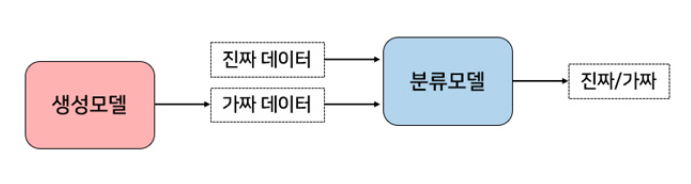

적대적 학습에서는 분류 모델을 먼저 학습시킨 후, 생성 모델을 학습시키는 과정을 서로 주고받으면서 반복합니다. 분류 모델의 학습은 크게 두 가지 단계로 이루어져 있습니다. 하나는 진짜 데이터를 입력해서 네트워크가 해당 데이터를 진짜로 분류하도록 학습시키는 과정이고 두 번째는 첫 번째와 반대로 생성 모델에서 생성한 가짜 데이터를 입력해서 해당 데이터를 가짜로 분류하도록 학습하는 과정입니다. 이 과정을 통해 분류 모델은 진짜 데이터를 진짜로, 가짜 데이터를 가짜로 분류할 수 있게 됩니다. 분류 모델을 학습시킨 다음에는 학습된 분류 모델을 속이는 방향으로 생성 모델을 학습시켜줘야 합니다. 생성 모델에서 만들어낸 가짜 데이터를 판별 모델에 입력하고, 가짜 데이터를 진짜라고 분류할 만큼 진짜 데이터와 유사한 데이터를 만들어 내도록 생성 모델을 학습시킵니다.

이와 같은 학습과정을 반복하면 분류 모델과 생성 모델이 서로를 적대적인 경쟁자로 인식하여 모두 발전하게 됩니다. 결과적으로, 생성 모델은 진짜 데이터와 완벽히 유사한 가짜 데이터를 만들 수 있게 되고 이에 따라 분류 모델은 진짜 데이터와 가짜 데이터를 구분할 수 없게 됩니다. 즉, GAN은 생성 모델은 분류에 성공할 확률을 낮추려 하고, 분류 모델은 분류에 성공할 확률을 높이려 하면서 서로가 서로를 경쟁적으로 발전시키는 구조를 이루고 있습니다.

출처 : https://www.samsungsds.com/kr/insights/Generative-adversarial-network-AI-2.html

# Generator 모델 구조
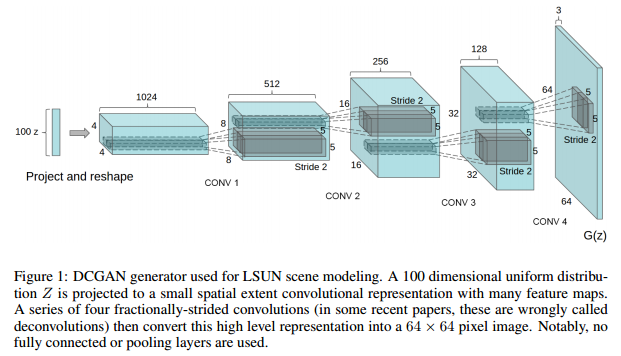


# step 1. 작업환경 구성하기
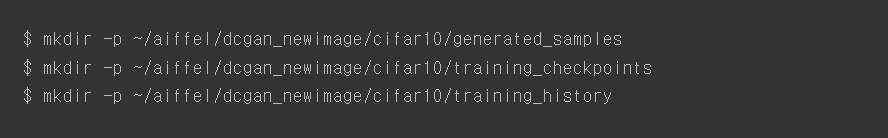

# step 2. 데이터 셋 구성하기

In [4]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers

from IPython import display
from tensorflow.keras.utils import plot_model
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.6.0


In [5]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x.shape

(50000, 32, 32, 3)

In [6]:
# train_x의 이미지를 -1, 1로 정규화
train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

print("max pixel:", train_x.max())
print("min pixel:", train_x.min())

max pixel: 1.0
min pixel: -1.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(50000, 32, 32, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

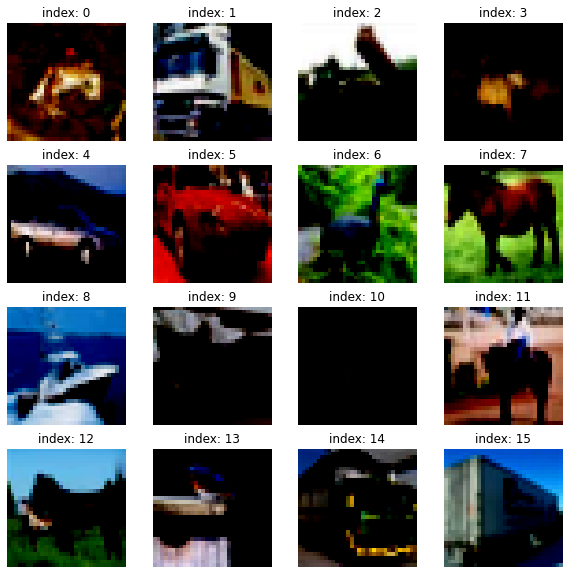

In [7]:
# 로드한 학습 데이터를 시각화를 통해 확인
print(train_x.shape)

# train_x = np.clip(train_x, -1.0, 1.0)

# train_x = train_x.reshape(train_x.shape[0], 32, 32, 3).astype('float32')

plt.figure(figsize=(10, 10)) # 프레임 크기 결정

for i in range(16):
    plt.subplot(4, 4, i+1) # 여러 이미지 띄우기
    plt.imshow(train_x[i].reshape(32, 32,3))
    plt.title(f'index: {i}')
    plt.axis('off')
plt.show()

In [8]:
# tf.data.Dataset 모듈의 from_tensor_slices() 함수를 사용하여 미니배치 데이터셋을 구성해 봅시다.

BUFFER_SIZE = 50000
BATCH_SIZE = 256

train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# step 3. 생성자 모델 구현하기

In [ ]:
# (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수를 작성

def make_generator_model():
    model=None
    # Start
    model = tf.keras.Sequential()

    # First: Dense layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Second: Reshape layer
    model.add(layers.Reshape((8, 8, 256)))

    # Third: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(128, kernel_size=(5, 5), strides=(1, 1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fourth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(64, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    # Fifth: Conv2DTranspose layer
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))

    return model

generator = make_generator_model()

generator.summary()

In [ ]:
# noise = tf.random.normal([1, 100])로 생성된 랜덤 노이즈를 입력으로 하여 방금 구현한 생성자로 랜덤 이미지를 생성해 봅시다.
noise = tf.random.normal([1, 100])

In [ ]:
# 생성된 랜덤 이미지가 생성자 출력 규격에 잘 맞는지 확인해 봅시다.
generated_image = generator(noise, training=False)
generated_image.shape

In [ ]:
# 여기 주의
plt.imshow((generated_image[0]+ 1.0) / 2.0)
plt.colorbar()
plt.show()

# step 4. 판별자 모델 구현하기

In [ ]:
# (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 
#판별자 모델 구현 함수

def make_discriminator_model():
    model=None

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

discriminator = make_discriminator_model()

discriminator.summary()

In [ ]:
# 위 STEP 2에서 생성한 랜덤 이미지를 판별자 모델이 판별한 결과값을 확인해 봅시다.
decision = discriminator(generated_image, training=False)
decision

# STEP 5. 손실함수와 최적화 함수 구현하기


In [ ]:
# 생성자와 판별자의 손실함수(loss)를 구현

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
# 판별자의 출력값을 가지고 실제/생성(real/fake)
# 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현

def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [ ]:
# 생성자와 판별자를 최적화하는 optimizer를 정의
# 1e-4 = 0.0001

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

# STEP 6. 훈련과정 상세 기능 구현하기


In [ ]:
# 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현

@tf.function
def train_step(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape()as disc_tape: 
        #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True) 
        #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy\
        (real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss,\
                                               generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient\
    (disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(\
              gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(\
              gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리

    

In [ ]:
# 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 
# 시각화하는 generate_and_save_images() 함수를 구현
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    np_predictions = predictions.numpy()
    np_predictions = (np_predictions * 127.5) + 127.5 # 정규화 했던 것을 되돌리기
    np_predictions = np_predictions.astype(int)   
        
    # 여기 주의
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(np_predictions[i])
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()
    


In [ ]:
# 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를 그래프로 
# 시각화하는 draw_train_history() 함수를 구현
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [ ]:
# training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 
# checkpoint 모듈을 설정
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

# step 7. 학습 과정 진행하기


In [ ]:
# 위 STEP 5에서 구현한 기능들을 활용하여 최소 50 epoch만큼의 모델 학습 진행
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)
        
save_every = 5
EPOCHS = 50

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")        

In [ ]:
%%time

# linemagic
# 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

train(train_dataset, EPOCHS, save_every)


In [ ]:
# 학습 과정을 담은 샘플 이미지, gif 파일, 학습 진행 그래프 이미지를 함께 제출

def make_samples_gif(file_name):
    anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/'+file_name+'_sample.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

# !ls -l ~/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif

In [ ]:
def make_training_history_gif(file_name):
    anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/'+file_name+'_history.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history*.png'.format(os.getenv('HOME')))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

# !ls -l ~/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif

In [ ]:
make_samples_gif('last_origin')
make_training_history_gif('last_origin')

# 기존 모델 성능 판단하기




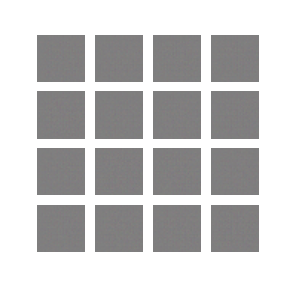



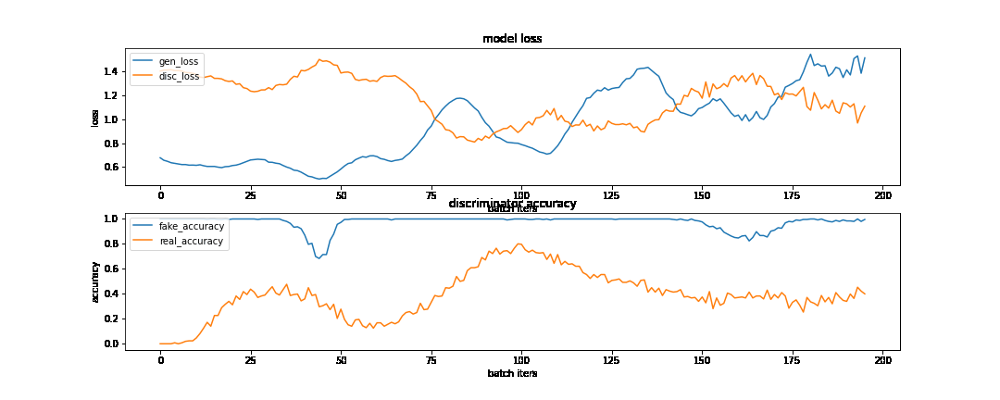




- 기존 모델의 경우, 형체가 생길듯,,말듯,,하며 결국엔 생기지 않았습니다. 이 경우 GAN의 학습능력이 아직 학습중인 과도기이거나 모델이나 하이퍼파라미터 적용 실패~~(생각하고싶지않군..!)~~라고 생각했습니다. 그래서 학습률을 높일 수 있는 하이퍼 파라미터들을 새로 적용해보고, 에포크도 늘려보기로 하였습니다.


# step 8.  (optional) GAN 훈련 과정 개선하기

STEP 6을 진행하면서 생성된 샘플 이미지, 학습 과정 그래프 등을 통해 이전 훈련 과정의 문제점을 분석해 봅시다.
모델구조 또는 학습 과정을 개선한 내역과 그 결과(샘플 이미지, 학습 과정 그래프 포함)를 함께 제출합니다.
(참고) 아래 언급된 페이지들에서 개선을 위한 아이디어를 얻을 수 있을 것입니다.

- [How to Train a GAN? Tips and tricks to make GANs work](https://github.com/soumith/ganhacks)
- [10 Lessons I Learned Training GANs for one Year](https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628)
- [Tips for Training Stable Generative Adversarial Networks](https://machinelearningmastery.com/how-to-train-stable-generative-adversarial-networks/)
- [Improved Techniques for Training GANs(paper)](https://proceedings.neurips.cc/paper/2016/file/8a3363abe792db2d8761d6403605aeb7-Paper.pdf)

# 성능 개선 시도 1. 옵티마이저와 드롭아웃 적용 & epoch=100
- https://github.com/soumith/ganhacks 링크에서 참고한 내용

1. 옵티마이저
discriminator에 sgd를, generator에 adam을 적용하라!

2. ~~학습 및 테스트 단계 모두에서 G의 드롭아웃 사용~~
- 2번의 경우, DCGAN이 아니라 pix2pix였어서 사용X, 하지만 다음에 꼭 사용해보고싶음!

3. 50에는 형체로 수렴하지가 않아서 100으로 수정해보았습니다.

In [ ]:
# 3. epoch = 100
save_every = 10
EPOCHS = 100

In [ ]:
# 1. 
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.SGD(1e-4)

In [ ]:
# %%time

# # linemagic
# # 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

# train(train_dataset, EPOCHS, save_every)

# make_samples_gif('reset_after_optimizer')
# make_training_history_gif('reset_after_optimizer')

In [ ]:
# # 2. 
# # https://machinelearningmastery.com/how-to-implement-pix2pix-gan-models-from-scratch-with-keras/


# def define_encoder_block(layer_in, n_filters, batchnorm=True):
#     # weight initialization
#     init = RandomNormal(stddev=0.02)
#     # add downsampling layer
#     g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
#     # conditionally add batch normalization
#     if batchnorm:
#         g = BatchNormalization()(g, training=True)
#     # leaky relu activation
#     g = LeakyReLU(alpha=0.2)(g)
#     return g

# def decoder_block(layer_in, skip_in, n_filters, dropout=True):
#     # weight initialization
#     init = RandomNormal(stddev=0.02)
#     # add upsampling layer
#     g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
#     # add batch normalization
#     g = BatchNormalization()(g, training=True)
#     # conditionally add dropout
#     if dropout:
#         g = Dropout(0.5)(g, training=True)
#     # merge with skip connection
#     g = Concatenate()([g, skip_in])
#     # relu activation
#     g = Activation('relu')(g)
#     return g



In [ ]:
# from keras.initializers import RandomNormal
# from keras.models import Model
# from keras.models import Input
# from keras.layers import Conv2D
# from keras.layers import Conv2DTranspose
# from keras.layers import LeakyReLU
# from keras.layers import Activation
# from keras.layers import Concatenate
# from keras.layers import Dropout
# from keras.layers import BatchNormalization
# from keras.layers import LeakyReLU
# from keras.utils.vis_utils import plot_model


# def make_generator_model_dropout(image_shape=(100,)):
#     # weight initialization
#     init = RandomNormal(stddev=0.02)
#     # image input
#     in_image = Input(shape=image_shape)
#     # encoder model: C64-C128-C256-C512-C512-C512-C512-C512
#     e1 = define_encoder_block(in_image, 64, batchnorm=False)
#     e2 = define_encoder_block(e1, 128)
#     e3 = define_encoder_block(e2, 256)
#     e4 = define_encoder_block(e3, 512)
#     e5 = define_encoder_block(e4, 512)
#     e6 = define_encoder_block(e5, 512)
#     e7 = define_encoder_block(e6, 512)
#     # bottleneck, no batch norm and relu
#     b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
#     b = Activation('relu')(b)
#     # decoder model: CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128
#     d1 = decoder_block(b, e7, 512)
#     d2 = decoder_block(d1, e6, 512)
#     d3 = decoder_block(d2, e5, 512)
#     d4 = decoder_block(d3, e4, 512, dropout=False)
#     d5 = decoder_block(d4, e3, 256, dropout=False)
#     d6 = decoder_block(d5, e2, 128, dropout=False)
#     d7 = decoder_block(d6, e1, 64, dropout=False)
#     # output
#     g = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
#     out_image = Activation('tanh')(g)
#     # define model
#     model = Model(in_image, out_image)
#     return model

# generator_dropout = make_generator_model_dropout()

# generator_dropout.summary()

In [ ]:

# def make_discriminator_model_dropout():

#     # Start
#     model = tf.keras.Sequential()

#     # First: Conv2D Layer
#     model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     # Second: Conv2D Layer
#     model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
#     model.add(layers.LeakyReLU())
#     model.add(layers.Dropout(0.3))

#     # Third: Flatten Layer
#     model.add(layers.Flatten())

#     # Fourth: Dense Layer
#     model.add(layers.Dense(1))

#     return model

# discriminator_dropout = make_discriminator_model_dropout()

# discriminator_dropout.summary()

# 성능 개선 시도 2. 학습률 변경

- https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628 링크 참고

- 생성기 0.0001 학습률, 판별자 0.0004 학습률 적용

참고 링크에서, 판별자에 대해 더 높은 학습률을 선택하고, 생성자에 대해 더 낮은 학습률을 선택하는 것이 좋다는 것을 배웠습니다. 그래서 생성기에 0.0001, 판별자에 0.0004 학습률을 적용해 주었습니다.


In [ ]:
# 1. 생성기 0.0001 학습률, 판별자 0.0004 학습률 적용

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(4e-4)



In [ ]:
# 3. epoch = 100
save_every = 10
EPOCHS = 100

In [ ]:
# %%time


# # linemagic
# # 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

# train(train_dataset, EPOCHS, save_every)

# make_samples_gif('reset_after_op_lr')
# make_training_history_gif('reset_after_op_lr')

# 성능 개선 시도 3. Spectral Normalization 적용

- https://towardsdatascience.com/10-lessons-i-learned-training-generative-adversarial-networks-gans-for-a-year-c9071159628 링크 참고

- Spectral Normalization 적용

참고 링크에서, convolutional kernel 에 적용된 특정 종류의 normalization인 Spectral Normalization 이 훈련의 안정성에 크게 도움이 될 수 있음을 보여준다고 하였습니다. 생성자에서 normalization을 Spectral Normalization으로 변경해 주었습니다.
- 코드 참고 : https://github.com/christiancosgrove/pytorch-spectral-normalization-gan

참고링크
- https://www.tensorflow.org/addons?hl=ko
- https://www.tensorflow.org/addons/api_docs/python/tfa/layers/SpectralNormalization


In [ ]:
# (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수를 작성
import tensorflow_addons as tfa

def make_generator_model_spectral():

    model = tf.keras.Sequential([
        # First: Dense layer
        tf.keras.layers.Dense(8*8*256, use_bias=False, input_shape=(100,)),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(),
        
        # Second : Reshape layer
        tf.keras.layers.Reshape((8,8,256)),

        # Third: Conv2DTranspose layer
        tfa.layers.SpectralNormalization(tf.keras.layers.Conv2DTranspose(128, kernel_size=(5, 5), \
                                        strides=(1, 1), padding='same', use_bias=False)),
        tf.keras.layers.LeakyReLU(),

        # Fourth: Conv2DTranspose layer
        tfa.layers.SpectralNormalization(tf.keras.layers.Conv2DTranspose(64, kernel_size=(5, 5), \
                                        strides=(2, 2), padding='same', use_bias=False)),
        tf.keras.layers.LeakyReLU(),

        # Fifth: Conv2DTranspose layer
        tf.keras.layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', \
                                        use_bias=False, activation='tanh')
        
    ])

    return model

generator_spectral = make_generator_model_spectral()

generator_spectral.summary()

In [ ]:
generated_image = generator_spectral(noise, training=False)
print(generated_image.shape)

# 여기 주의
plt.imshow((generated_image[0]+ 1.0) / 2.0)
plt.colorbar()
plt.show()

In [ ]:
# 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현

@tf.function
def train_step_after_sn(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape()as disc_tape: 
        #(3) tf.GradientTape() 오픈
        generated_images = generator_spectral(noise, training=True) 
        #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy\
        (real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss,\
                                               generator_spectral.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient\
    (disc_loss, discriminator.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(\
              gradients_of_generator, generator_spectral.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(\
              gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리

    

In [ ]:
# 위 STEP 5에서 구현한 기능들을 활용하여 최소 50 epoch만큼의 모델 학습 진행
def train_after_sn(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator_spectral, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)
        
save_every = 5
EPOCHS = 50

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")        

In [ ]:
# training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 
# checkpoint 모듈을 설정
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator_spectral,
                                 discriminator=discriminator)

In [ ]:
# 3. epoch = 100
save_every = 10
EPOCHS = 100

In [ ]:
%%time


# linemagic
# 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

train_after_sn(train_dataset, EPOCHS, save_every)

In [ ]:
make_samples_gif('last_reset_after_SN')
make_training_history_gif('last_reset_after_SN')

# 성능 개선 시도 4. Dropout 변경
성능개선 1에 참고한 [링크](https://github.com/soumith/ganhacks)에서 Dropout 퍼센트를 0.5로 보통 많이 사용한다기에 판별자의 Dropout 비율을 0.3-> 0.5로 적용해 주었습니다.

In [ ]:
# (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 
#판별자 모델 구현 함수 dropout 0.5 적용

def make_discriminator_model_spectral():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

discriminator_spectral = make_discriminator_model_spectral()

discriminator_spectral.summary()

In [ ]:
decision_spectral = discriminator_spectral(generated_image, training=False)
decision_spectral

In [ ]:
# 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현

@tf.function
def train_step_after_dropout(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape()as disc_tape: 
        #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True) 
        #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator_spectral(images, training=True)
        fake_output = discriminator_spectral(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy\
        (real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss,\
                                               generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient\
    (disc_loss, discriminator_spectral.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(\
              gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(\
              gradients_of_discriminator, discriminator_spectral.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리

    

In [ ]:
def train_after_dropout(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step_after_dropout(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [ ]:
# training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 
# checkpoint 모듈을 설정
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator_spectral)

In [ ]:
# 3. epoch = 100
save_every = 10
EPOCHS = 100

In [ ]:
%%time


# linemagic
# 학습 과정에서 생성된 샘플 이미지로 만든 gif 파일을 통해 학습 진행 과정을 시각적으로 표현

train_after_dropout(train_dataset, EPOCHS, save_every)

In [ ]:
make_samples_gif('reset_after_dropout')
make_training_history_gif('reset_after_dropout')

# 성능개선 결과
- 공통적으로 에포크는 전부 100으로 학습을 시도하였다.

## 시도 1. 옵티마이저 변경
discriminator에 sgd를, generator에 adam을 적용
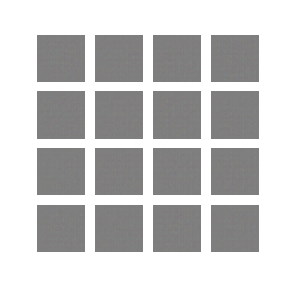


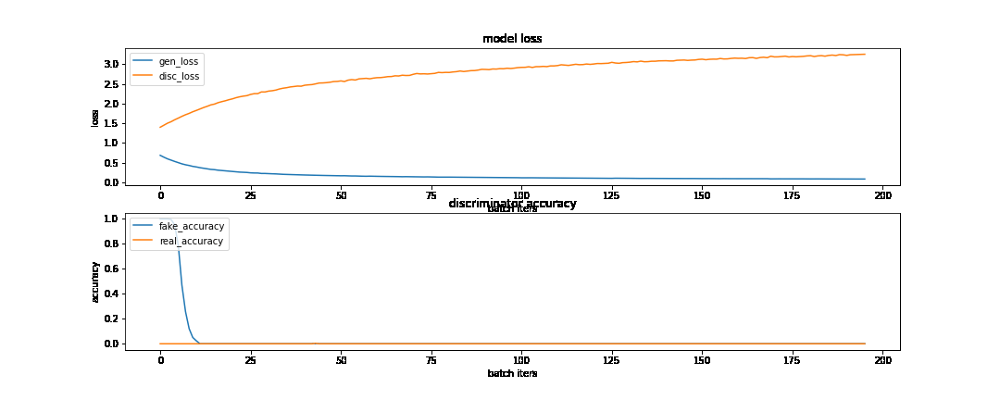

아주 효과가 형편없었다. 전체 그림이 동일한 결과값을 내뱉는 처참한 결과였다.~~오래보면 마약한듯한 효과가 날것같은 그림이라니 너무 충격적이었다.~~ 이는 사용하지 않기로하였다. ~~블로그에서 추천해줬는데..!~~

## 시도 2. 학습률 변경
생성기 0.0001 학습률, 판별자 0.0004 학습률 적용

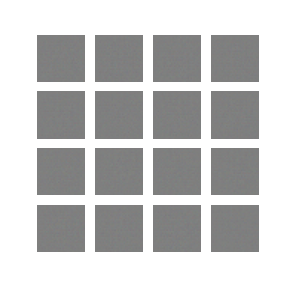

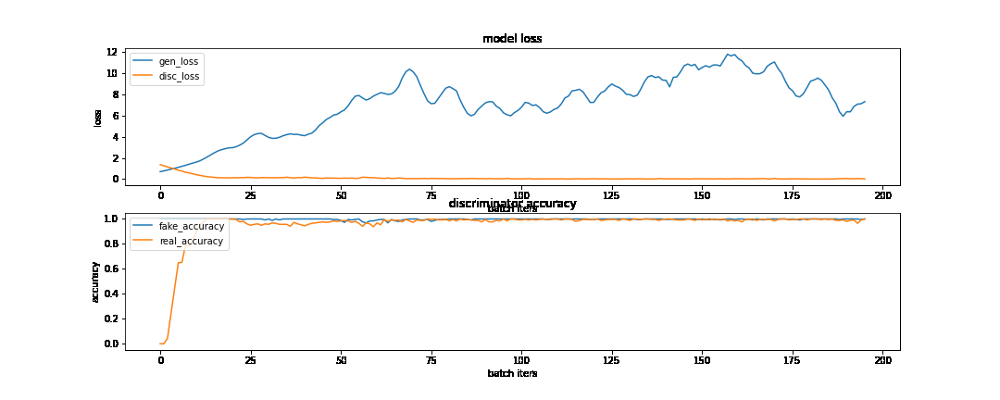
딱봐도 효과가 좋았다. 각각의 그림이 다른 형체로 수렴하기 시작한 것을 확인할 수 있다.

## 시도 3. Spectral Normalization 사용
convolutional kernel 에 적용된 Spectral Normalization를 사용

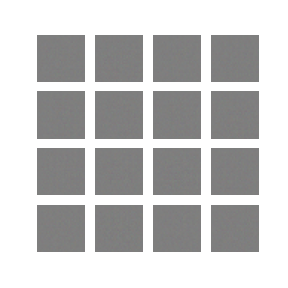


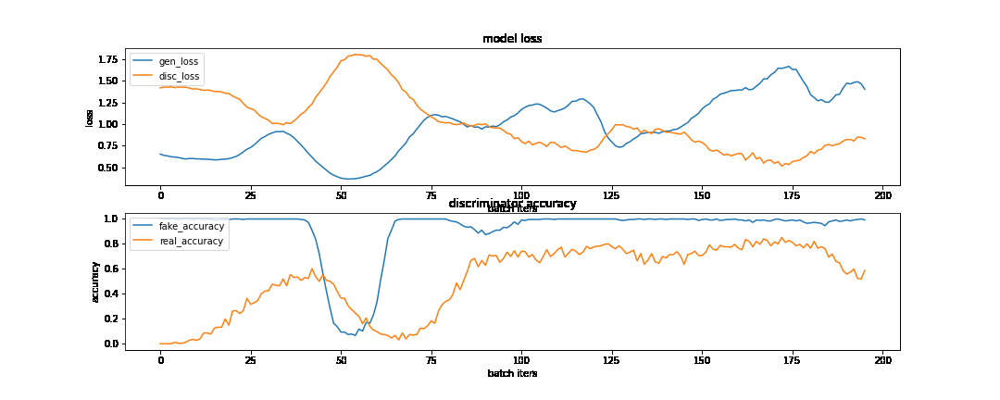



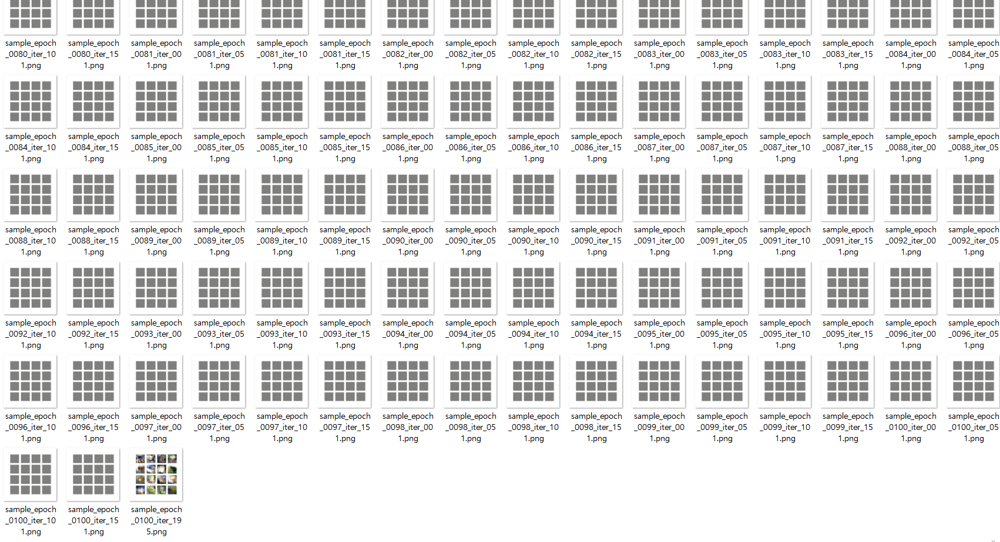

알다가도 모르겠는 step이다 다 회색이다가 가끔 저렇게 노이즈 이미지가 뜨고 맨 마지막에는 아래 이미지처럼 그럴듯한게 떴다.


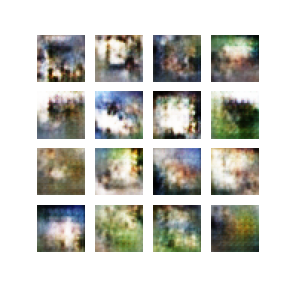

참고했던 블로그에서 정말 강력추천하는 방법이라길래, 코드찾느라 이거 저거 시도해보고 시간을 들여 수정해놨더니 효과가 있는지 없는지 모르겠다,,

## 시도 4. dropout 변경
판별자의 Dropout 비율을 0.3-> 0.5로 적용

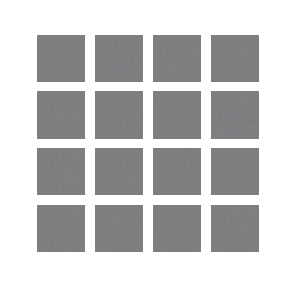

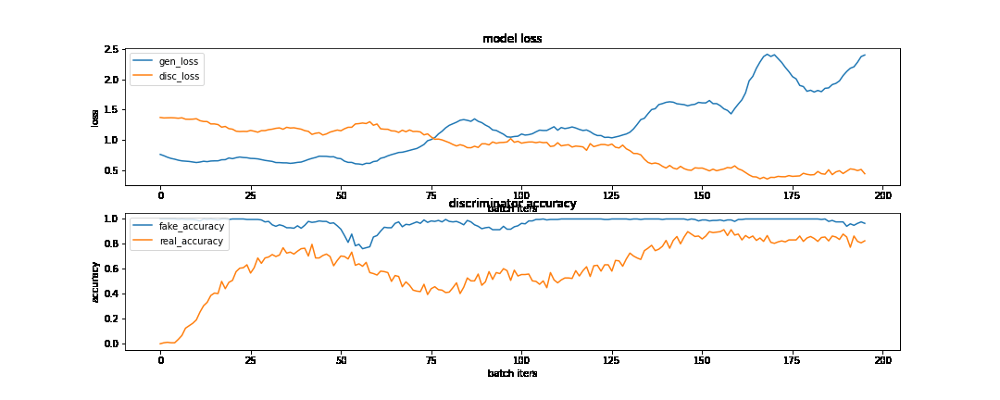

마찬가지로 성능개선이 꽤 된것 같습니다.

## 시도들 정리

시도 1번은 별로였고, 2, 4는 꽤나 눈에 보이는 성능개선이, 3번은 애매합니다. 그래서 있는것 한번, 없는것 한번 돌려보기로했습니다.

# 성능 개선 최종 시도 5. 에포크 증가 with SN
 


In [ ]:
save_every = 50
EPOCHS = 500

In [ ]:
cifar10 = tf.keras.datasets.cifar10

(train_x, _), (test_x, _) = cifar10.load_data()

train_x = (train_x - 127.5) / 127.5 # 이미지를 [-1, 1]로 정규화합니다.

BUFFER_SIZE = 50000
BATCH_SIZE = 256

train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)


In [ ]:
# (32, 32, 3)의 shape를 가진 이미지를 생성하는 생성자 모델 구현 함수를 작성
import tensorflow_addons as tfa

def make_generator_model_spectral():

    model = tf.keras.Sequential([
        # First: Dense layer
        tf.keras.layers.Dense(8*8*256, use_bias=False, input_shape=(100,)),
        tf.keras.layers.BatchNormalization(),
        tf.keras.layers.LeakyReLU(),
        
        # Second : Reshape layer
        tf.keras.layers.Reshape((8,8,256)),

        # Third: Conv2DTranspose layer
        tfa.layers.SpectralNormalization(tf.keras.layers.Conv2DTranspose(128, kernel_size=(5, 5), \
                                        strides=(1, 1), padding='same', use_bias=False)),
        tf.keras.layers.LeakyReLU(),

        # Fourth: Conv2DTranspose layer
        tfa.layers.SpectralNormalization(tf.keras.layers.Conv2DTranspose(64, kernel_size=(5, 5), \
                                        strides=(2, 2), padding='same', use_bias=False)),
        tf.keras.layers.LeakyReLU(),

        # Fifth: Conv2DTranspose layer
        tf.keras.layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', \
                                        use_bias=False, activation='tanh')
        
    ])

    return model

generator_spectral = make_generator_model_spectral()

generator_spectral.summary()

In [ ]:
noise = tf.random.normal([1, 100])

In [ ]:
generated_image = generator_spectral(noise, training=False)
print(generated_image.shape)

# 여기 주의
plt.imshow((generated_image[0]+ 1.0) / 2.0)
plt.colorbar()
plt.show()

In [ ]:
# (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 
#판별자 모델 구현 함수 dropout 0.5 적용

def make_discriminator_model_spectral():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

discriminator_spectral = make_discriminator_model_spectral()

discriminator_spectral.summary()

In [ ]:
decision_spectral = discriminator_spectral(generated_image, training=False)
decision_spectral

In [ ]:
# 생성자와 판별자의 손실함수(loss)를 구현

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
# 판별자의 출력값을 가지고 실제/생성(real/fake)
# 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현

def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [ ]:
# 생성자와 판별자를 최적화하는 optimizer를 정의
# 1e-4 = 0.0001

generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(4e-4)

noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

In [ ]:
# 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현

@tf.function
def train_step_final(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape()as disc_tape: 
        #(3) tf.GradientTape() 오픈
        generated_images = generator_spectral(noise, training=True) 
        #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator_spectral(images, training=True)
        fake_output = discriminator_spectral(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy\
        (real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss,\
                                               generator_spectral.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient\
    (disc_loss, discriminator_spectral.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(\
              gradients_of_generator, generator_spectral.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(\
              gradients_of_discriminator, discriminator_spectral.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리

    

In [1]:
# 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 
# 시각화하는 generate_and_save_images() 함수를 구현
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

#     np_predictions = predictions.numpy()
#     np_predictions = (np_predictions * 127.5) + 127.5 # 정규화 했던 것을 되돌리기
#     np_predictions = np_predictions.astype(int)   
        
    # 여기 주의
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(predictions[i])
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()
    


In [ ]:
# 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를 그래프로 
# 시각화하는 draw_train_history() 함수를 구현
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [ ]:
# training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 
# checkpoint 모듈을 설정
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator_spectral,
                                 discriminator=discriminator_spectral)

In [ ]:
def train_final(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step_final(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator_spectral, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator_spectral, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [ ]:
tf.config.list_physical_devices("GPU")        

In [ ]:
# 학습 과정을 담은 샘플 이미지, gif 파일, 학습 진행 그래프 이미지를 함께 제출

def make_samples_gif(file_name):
    anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/'+file_name+'_sample.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample*.png'.format(os.getenv('HOME')))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

# !ls -l ~/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif

In [ ]:
def make_training_history_gif(file_name):
    anim_file = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/'+file_name+'_history.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history*.png'.format(os.getenv('HOME')))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)

# !ls -l ~/aiffel/dcgan_newimage/fashion/fashion_mnist_dcgan.gif

In [3]:
%%time
# train_final(train_dataset, EPOCHS, save_every)
make_samples_gif('final_test')
make_training_history_gif('final_test')

NameError: name 'make_samples_gif' is not defined

# 성능 개선 최종 시도 6. 에포크 증가 without SN


In [ ]:
save_every = 50
EPOCHS = 500

In [ ]:
# (32, 32, 3)의 이미지를 입력으로 받아 1dim을 판별결과를 출력하는 
#판별자 모델 구현 함수 dropout 0.5 적용

def make_discriminator_model_spectral():

    # Start
    model = tf.keras.Sequential()

    # First: Conv2D Layer
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[32, 32, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Second: Conv2D Layer
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.5))

    # Third: Flatten Layer
    model.add(layers.Flatten())

    # Fourth: Dense Layer
    model.add(layers.Dense(1))

    return model

discriminator_spectral = make_discriminator_model_spectral()

discriminator_spectral.summary()

In [ ]:
decision_spectral = discriminator_spectral(generated_image, training=False)
decision_spectral

In [ ]:
# 생성자와 판별자의 손실함수(loss)를 구현

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
# 판별자의 출력값을 가지고 실제/생성(real/fake)
# 이미지 판별 정확도(accuracy)를 계산하는 함수를 구현

def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

In [ ]:
# 생성자와 판별자를 최적화하는 optimizer를 정의
# 1e-4 = 0.0001

# generator_optimizer = tf.keras.optimizers.Adam(1e-4)
# discriminator_optimizer = tf.keras.optimizers.Adam(4e-4)

noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

In [ ]:
# 16개의 고정된 seed를 입력으로 하여 훈련 과정 동안 생성한 이미지를 
# 시각화하는 generate_and_save_images() 함수를 구현
def generate_and_save_images(model, epoch, it, sample_seeds):

    predictions = model(sample_seeds, training=False)

    np_predictions = predictions.numpy()
    np_predictions = (np_predictions * 127.5) + 127.5 # 정규화 했던 것을 되돌리기
    np_predictions = np_predictions.astype(int)   
        
    # 여기 주의
    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(np_predictions[i])
        plt.axis('off')
   
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'
                    .format(os.getenv('HOME'), epoch, it))

    plt.show()
    


In [ ]:
# 훈련 epoch마다 생성자/판별자의 loss 및 판별자의 실제/생성(real/fake) 이미지 판별 accuracy 히스토리(history)를 그래프로 
# 시각화하는 draw_train_history() 함수를 구현
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6    # matlab 차트의 기본 크기를 15,6으로 지정해 줍니다.

def draw_train_history(history, epoch):
    # summarize history for loss  
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')  

    # summarize history for accuracy  
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    # training_history 디렉토리에 epoch별로 그래프를 이미지 파일로 저장합니다.
    plt.savefig('{}/aiffel/dcgan_newimage/cifar10/training_history/train_history_{:04d}.png'
                    .format(os.getenv('HOME'), epoch))
    plt.show()

In [ ]:
# 1개 미니배치의 훈련 과정을 처리하는 train_step() 함수를 구현

@tf.function
def train_step_after_dropout(images):  #(1) 입력데이터
    noise = tf.random.normal([BATCH_SIZE, noise_dim])  #(2) 생성자 입력 노이즈

    with tf.GradientTape() as gen_tape, tf.GradientTape()as disc_tape: 
        #(3) tf.GradientTape() 오픈
        generated_images = generator(noise, training=True) 
        #(4) generated_images 생성

        #(5) discriminator 판별
        real_output = discriminator_spectral(images, training=True)
        fake_output = discriminator_spectral(generated_images, training=True)

        #(6) loss 계산
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

        #(7) accuracy 계산
        real_accuracy, fake_accuracy = discriminator_accuracy\
        (real_output, fake_output) 
    
    #(8) gradient 계산
    gradients_of_generator = gen_tape.gradient(gen_loss,\
                                               generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient\
    (disc_loss, discriminator_spectral.trainable_variables)

    #(9) 모델 학습
    generator_optimizer.apply_gradients(zip(\
              gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(\
              gradients_of_discriminator, discriminator_spectral.trainable_variables))

    return gen_loss, disc_loss, real_accuracy, fake_accuracy  #(10) 리

    

In [ ]:
def train_after_dropout(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step_after_dropout(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

In [ ]:
# training_checkpoints 디렉토리에 몇 epoch마다 모델을 저장하는 
# checkpoint 모듈을 설정
checkpoint_dir = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/training_checkpoints'

checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator_spectral)

In [ ]:
%%time

train_after_dropout(train_dataset, EPOCHS, save_every)

In [ ]:
make_samples_gif('last_final_without_sn')
make_training_history_gif('last_final_without_sn')

# 최종시도 결과정리

## 시도 2,3,4 


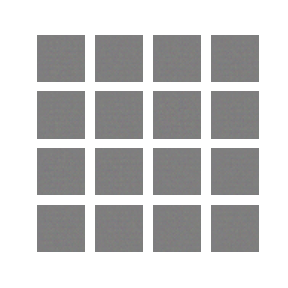

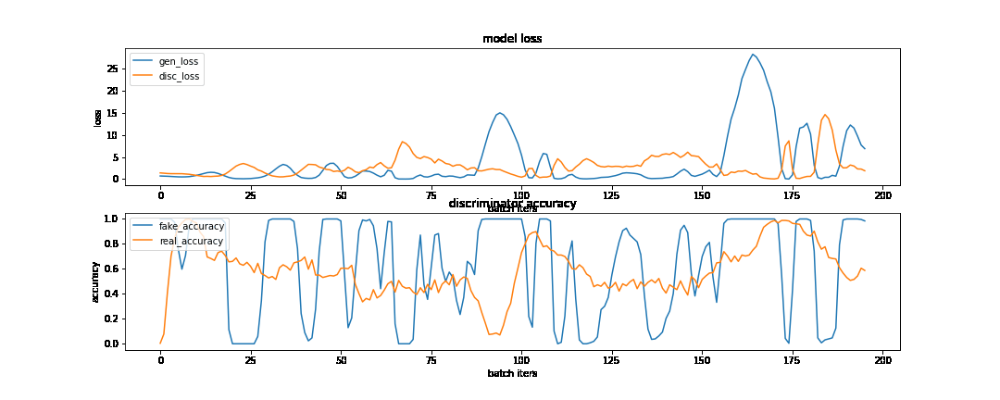

네~! 망했습니다. loss가 0에 수렴한다는 것은 거의 완벽하게 진짜와 가짜를 구별한다는 거고,, accuracy는 0.5에 가까워졌지만,, 그림 형태가 전혀 수렴하지 않았으므로 이 모델은 실패했다고 생각합니다.



## 시도 2, 4

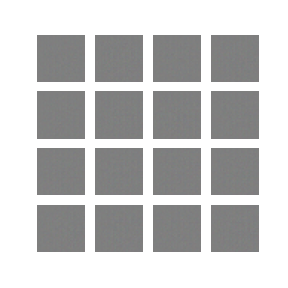



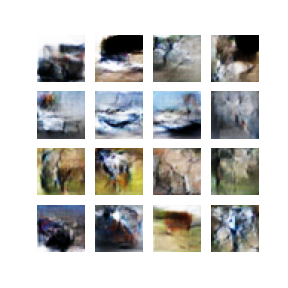

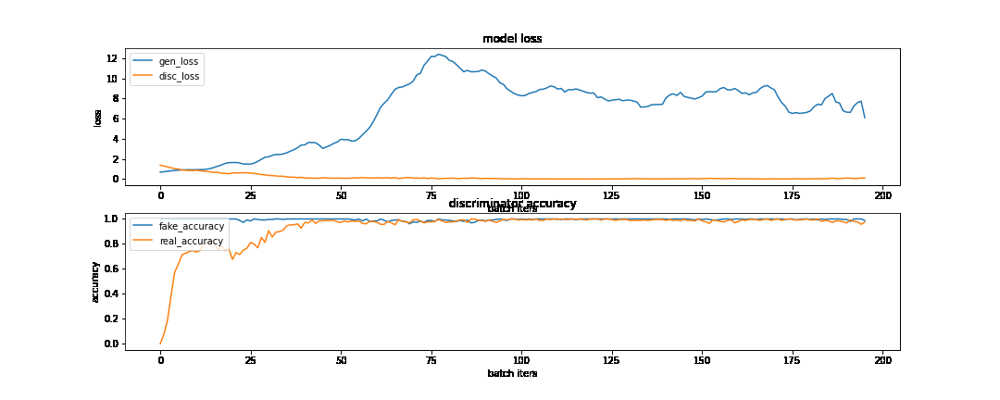

형체는 생기기 시작한 것 같은데 cifar10과 너무 다른것 같습니다. 동물의 형체가 가장 많이 보이는 것 같으나, 사실 그마저도 잘 모르겠습니다. accuracy가 0.5로 안정적으로 다가가고 있으나 loss가 너무 낮아서,, 학습이 잘되어가고있는지는 모르겠습니다.


## 생성된 모델


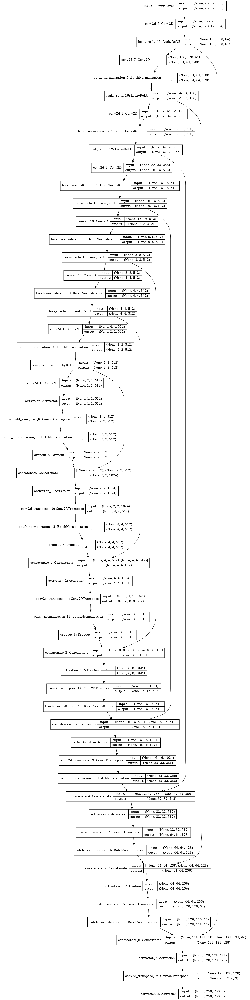


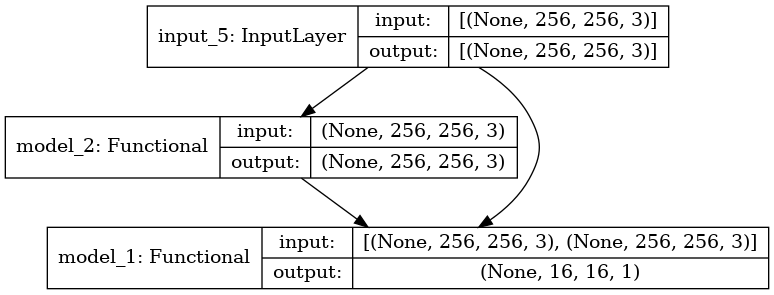



# 새로 배운 점

- `%%time`은 셀 매직이며, IPython셀에서 가장 첫줄에 존재해야합니다. 그렇지 않다면 line magic time not found 오류가 나오게 됩니다 [링크](https://stackoverflow.com/questions/65124633/line-magic-function-time-not-found)

# 회고

- 저번 익스부터 궁금했던 건데,, 대체 모델을 리셋하는 방법은 뭘까.

내가 하고싶은 것은 항상, 기존 모델을 한번 돌려놓고, 전부 새 데이터인 상태에서 하이퍼파라미터들을 하나씩 바꾸고 결과를 보며 비교한 후, 효과있는것만 넣어서 새로 돌리고싶었다.

하지만 기존모델을 돌리고, 기존에 선언되었던 하이퍼파라미터를 수정한 후, 학습을 새로 돌리면 처음 상태에서 시작할 수 있을줄 알았는데 항상 기존에 학습했던 데이터가 남아있었다. 

오늘 시도해보았던 것은, model 생성 함수에서 처음에 model = None 넣어주기 / model.reset으로 시작하는 메소드 전부 사용해보기 / generator_image는 기존 초기 리셋이미지가 살아있기에 생성자 재 선언해주기 / import부터 다시 해보기 / 데이터 세로 불러오기 등이다.

하지만 전부 기존 학습데이터가 남아있어서 커널을 죽이고 다시 돌렸어야했다.

이 문제 정.말 해결하고싶다.

- 블로그를 전부 믿어선 안된다.

블로그에서 이 방법이 좋다고 했는데 결과가 처참한 것도 있었고, 어떤 글에서는 Rekyrelu가 생성자에선 좋고 판별자에선 안좋다했던가? 근데 후에는 다 괜찮다라고 한글도있었다. 물론 성능개선 방법 중 하나라 그게 다른 상황에선 잘 될수도 있지만. 무조건 믿어선 안되겟다고 생각이 들었다.

- 내가 예상한것과 모델의 결과는 항상 예상밖이다.

이걸 사용하면 성능이 훨씬 좋아지겠지, 당연히 이건 이렇게 나올꺼야 했던 시도들이 예상외로 결과에 미비한 영향을 끼치거나 오히려 나빠질 때도 있었다. 그리고 내가 시간들여 노력해도 결과는 안좋을 수도있다. 하지만.. 이 경험들이 모여 더 나은 실력과 경험을 갖춘 내가 될거라고 믿고싶다.

- 결과그래프를 해석하자!

cv의 경우, 결과가 내 눈으로보이니, 결과화면만 보고 판단하는 경우가 많은데, loss나 accuracy 그래프를 시각화하고, 분석하는 습관을 들여야겠다고 생각했습니다.

# 후에 더 해보고 싶은 것 

- 블로그 서칭중 알게된 pix2pix 모델 코드
이 코드 다음에 꼭 사용해보고싶다.

https://machinelearningmastery.com/how-to-implement-pix2pix-gan-models-from-scratch-with-keras/

In [ ]:
# example of defining a u-net encoder-decoder generator model
from keras.initializers import RandomNormal
from keras.models import Model
from keras.models import Input
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Activation
from keras.layers import Concatenate
from keras.layers import Dropout
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU
from keras.utils.vis_utils import plot_model

# define an encoder block
def define_encoder_block(layer_in, n_filters, batchnorm=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

# define a decoder block
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # add batch normalization
    g = BatchNormalization()(g, training=True)
    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)
    # merge with skip connection
    g = Concatenate()([g, skip_in])
    # relu activation
    g = Activation('relu')(g)
    return g

# define the standalone generator model
def define_generator(image_shape=(256,256,3)):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # encoder model: C64-C128-C256-C512-C512-C512-C512-C512
    e1 = define_encoder_block(in_image, 64, batchnorm=False)
    e2 = define_encoder_block(e1, 128)
    e3 = define_encoder_block(e2, 256)
    e4 = define_encoder_block(e3, 512)
    e5 = define_encoder_block(e4, 512)
    e6 = define_encoder_block(e5, 512)
    e7 = define_encoder_block(e6, 512)
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    # decoder model: CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    # output
    g = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    # define model
    model = Model(in_image, out_image)
    return model

# define image shape
image_shape = (256,256,3)
# create the model
model = define_generator(image_shape)
# summarize the model
model.summary()
# plot the model
plot_model(model, to_file='generator_model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# from keras.optimizers import Adam # doesn't works
from tensorflow.keras.optimizers import Adam # - Works
from keras.initializers import RandomNormal
from keras.models import Model
from keras.models import Input
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Activation
from keras.layers import Concatenate
from keras.layers import Dropout
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU
from keras.utils.vis_utils import plot_model

# define the discriminator model
def define_discriminator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # source image input
    in_src_image = Input(shape=image_shape)
    # target image input
    in_target_image = Input(shape=image_shape)
    # concatenate images channel-wise
    merged = Concatenate()([in_src_image, in_target_image])
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)
    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # second last output layer
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    # patch output
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    patch_out = Activation('sigmoid')(d)
    # define model
    model = Model([in_src_image, in_target_image], patch_out)
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    return model

# define an encoder block
def define_encoder_block(layer_in, n_filters, batchnorm=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

# define a decoder block
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # add batch normalization
    g = BatchNormalization()(g, training=True)
    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)
    # merge with skip connection
    g = Concatenate()([g, skip_in])
    # relu activation
    g = Activation('relu')(g)
    return g

# define the standalone generator model
def define_generator(image_shape=(256,256,3)):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # encoder model: C64-C128-C256-C512-C512-C512-C512-C512
    e1 = define_encoder_block(in_image, 64, batchnorm=False)
    e2 = define_encoder_block(e1, 128)
    e3 = define_encoder_block(e2, 256)
    e4 = define_encoder_block(e3, 512)
    e5 = define_encoder_block(e4, 512)
    e6 = define_encoder_block(e5, 512)
    e7 = define_encoder_block(e6, 512)
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    # decoder model: CD512-CD1024-CD1024-C1024-C1024-C512-C256-C128
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    # output
    g = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    # define model
    model = Model(in_image, out_image)
    return model

# define the combined generator and discriminator model, for updating the generator
def define_gan(g_model, d_model, image_shape):
    # make weights in the discriminator not trainable
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False
    # define the source image
    in_src = Input(shape=image_shape)
    # connect the source image to the generator input
    gen_out = g_model(in_src)
    # connect the source input and generator output to the discriminator input
    dis_out = d_model([in_src, gen_out])
    # src image as input, generated image and classification output
    model = Model(in_src, [dis_out, gen_out])
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss=['binary_crossentropy', 'mae'], optimizer=opt, loss_weights=[1,100])
    return model

# define image shape
image_shape = (256,256,3)
# define the models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)
# define the composite model
gan_model = define_gan(g_model, d_model, image_shape)
# summarize the model
gan_model.summary()
# plot the model
plot_model(gan_model, to_file='gan_model_plot.png', show_shapes=True, show_layer_names=True)